<a href="https://colab.research.google.com/github/RaimanKrishna/geromicg.github.io/blob/main/WK10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [8]:
from google.colab import files

# Upload the file
uploaded = files.upload()


Saving india_states.geojson to india_states.geojson


In [9]:
import os

# List files in the current directory
print(os.listdir())



['.config', 'india-composite.geojson', 'india_states.geojson', 'india-composite (2).geojson', 'india-composite (1).geojson', 'sample_data']


In [10]:
import geopandas as gpd

# Load the GeoJSON file
gdf = gpd.read_file("/content/india_states.geojson")

# Display the first few rows to verify
print(gdf.head())


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...


In [11]:
from google.colab import drive

# Mount Google Drive
drive.mount('/content/drive')

# Save the file to a folder in your Google Drive
!cp india_states.geojson /content/drive/MyDrive/


Mounted at /content/drive


In [12]:
import geopandas as gpd

# Load the GeoJSON file
gdf = gpd.read_file("india_states.geojson")

# Check the first few rows
print(gdf.head())


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...


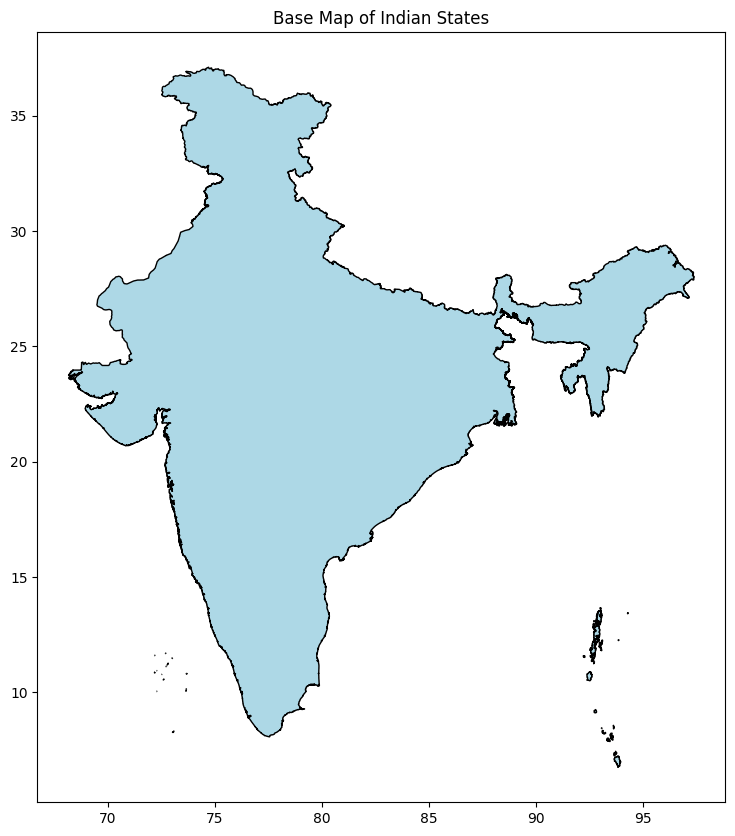

In [13]:
import matplotlib.pyplot as plt

# Plot the base map
gdf.plot(edgecolor="black", color="lightblue", figsize=(10, 10))
plt.title("Base Map of Indian States")
plt.show()


In [14]:
# Inspect the GeoDataFrame structure
print(gdf.head())
print(gdf.crs)  # Check the coordinate reference system
print(gdf.geometry)  # Check if geometry data exists


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
EPSG:4326
0    MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Name: geometry, dtype: geometry


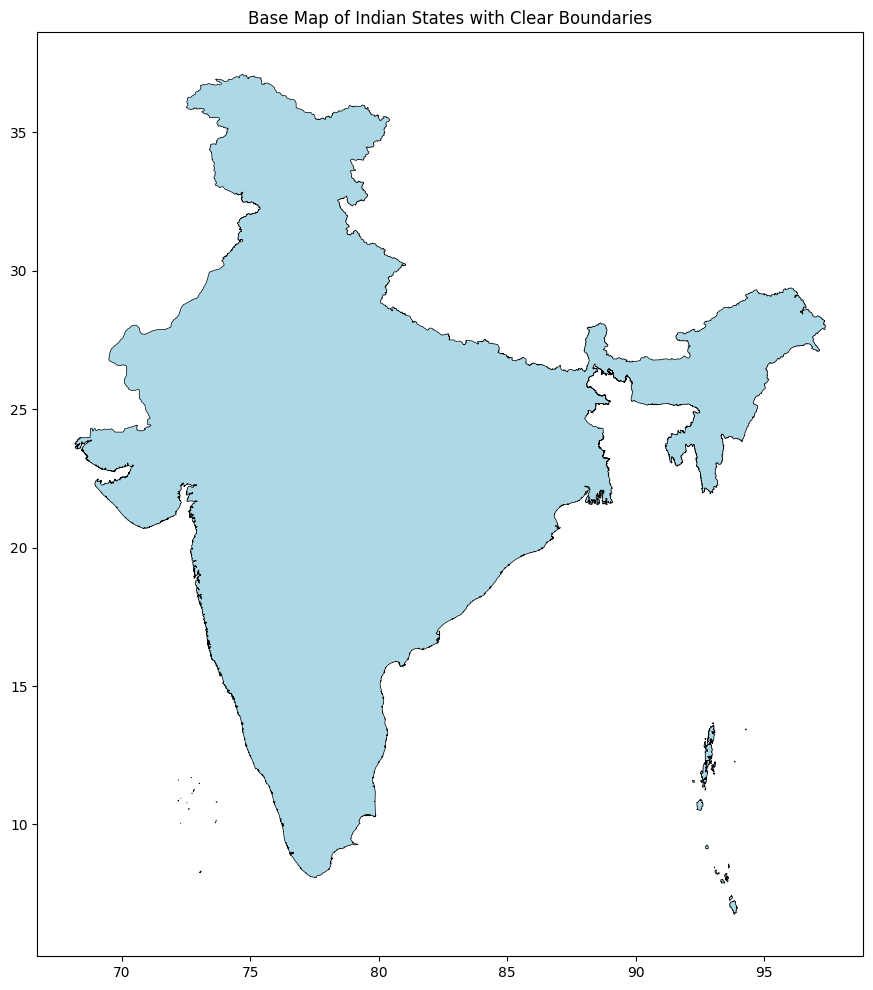

In [15]:
# Plot the base map with thicker boundaries
gdf.plot(edgecolor="black", color="lightblue", linewidth=0.5, figsize=(12, 12))
plt.title("Base Map of Indian States with Clear Boundaries")
plt.show()


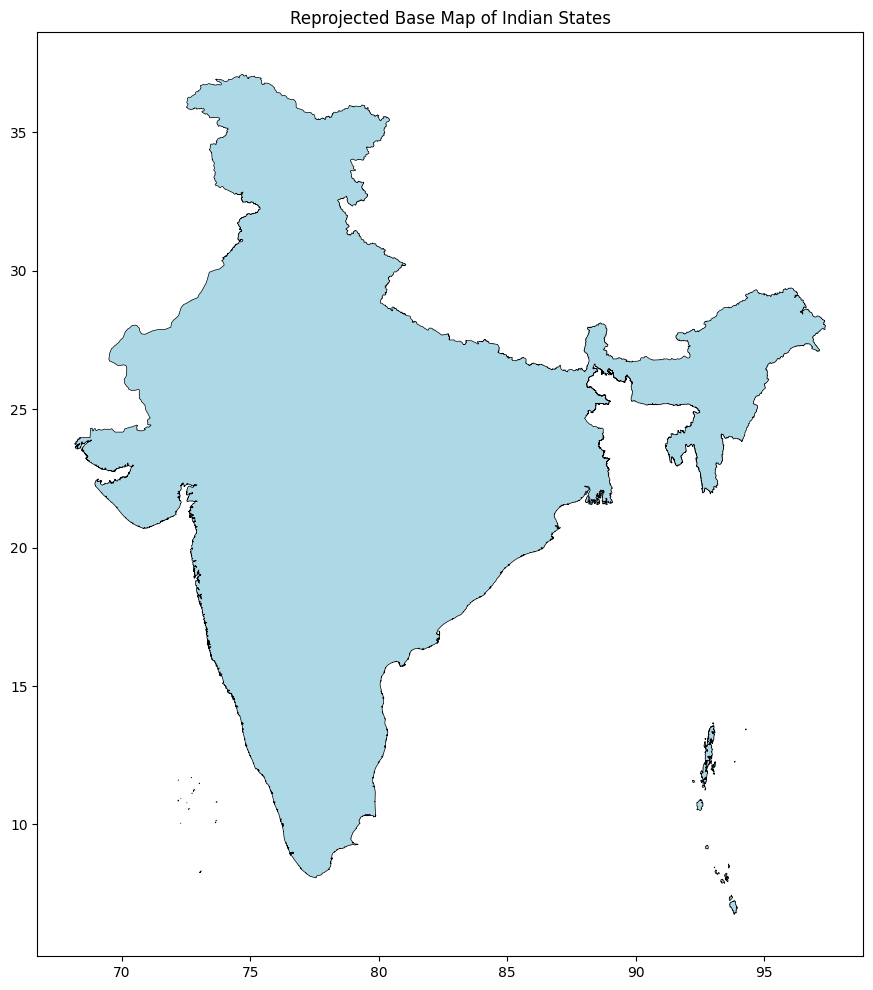

In [16]:
# Reproject to WGS84 CRS
gdf = gdf.to_crs(epsg=4326)

# Plot again after reprojection
gdf.plot(edgecolor="black", color="lightblue", linewidth=0.5, figsize=(12, 12))
plt.title("Reprojected Base Map of Indian States")
plt.show()


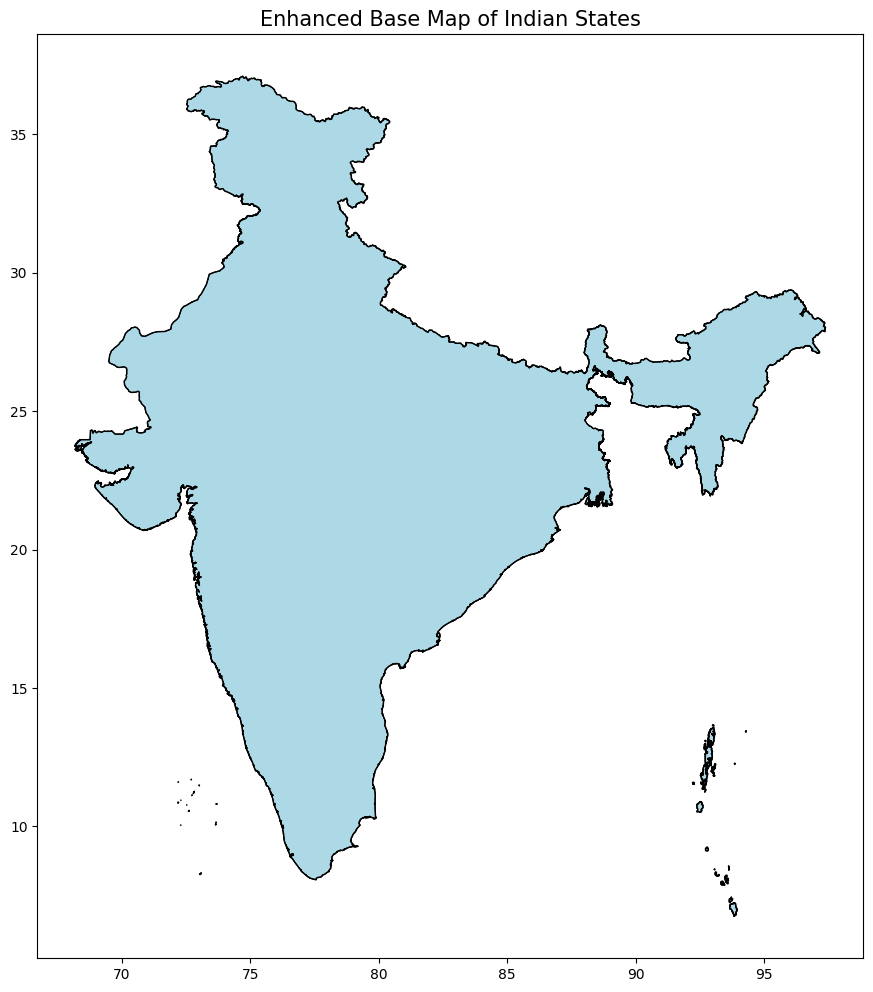

In [17]:
fig, ax = plt.subplots(1, 1, figsize=(12, 12))
gdf.boundary.plot(ax=ax, color="black", linewidth=0.8)  # Plot boundaries
gdf.plot(ax=ax, color="lightblue", edgecolor="black")  # Fill states
plt.title("Enhanced Base Map of Indian States", fontsize=15)
plt.show()


In [18]:
import geopandas as gpd

# Inspect the GeoJSON file
print(gdf.head())  # Check the first few rows
print(gdf.columns)  # List all columns in the GeoDataFrame
print(gdf.geometry)  # Check the geometry column


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Index(['geometry'], dtype='object')
0    MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Name: geometry, dtype: geometry


In [19]:
# Load the GeoJSON file
gdf = gpd.read_file("india_states.geojson")

# Ensure the file is loaded correctly
print(gdf.head())


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...


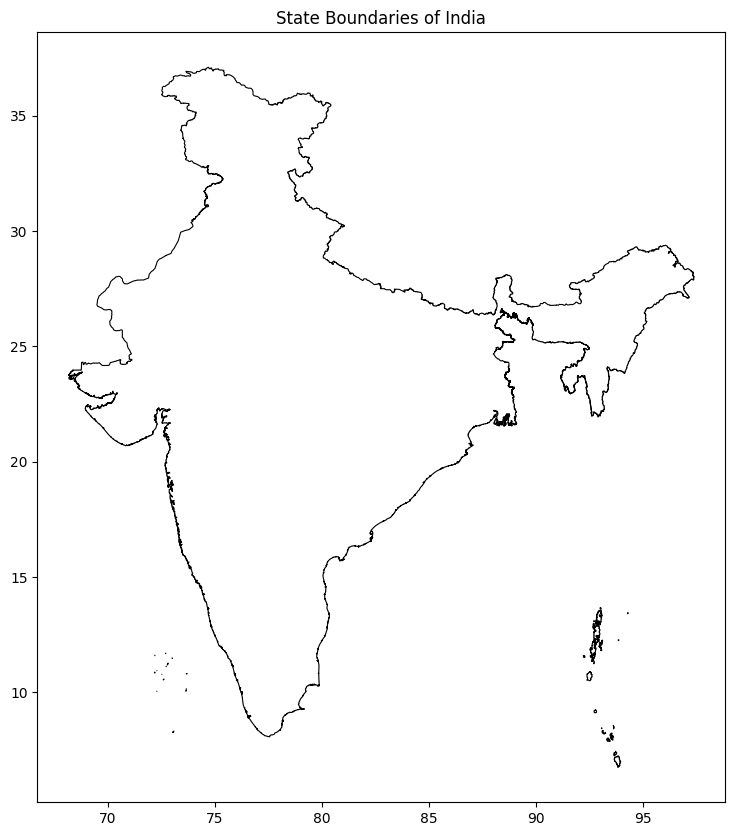

In [20]:
import matplotlib.pyplot as plt

# Plot the state boundaries
gdf.boundary.plot(color="black", linewidth=0.8, figsize=(10, 10))
plt.title("State Boundaries of India")
plt.show()


In [21]:
import geopandas as gpd

# Load the GeoJSON file
gdf = gpd.read_file("india_states.geojson")

# Inspect the first few rows of the GeoDataFrame
print(gdf.head())
print(gdf.geometry[:5])  # Check the first few geometries


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
0    MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Name: geometry, dtype: geometry


In [22]:
# Check for any null or invalid geometries
print(gdf[gdf.geometry.isnull()])

# Drop rows with invalid geometries if necessary
gdf = gdf.dropna(subset=["geometry"])


Empty GeoDataFrame
Columns: [geometry]
Index: []


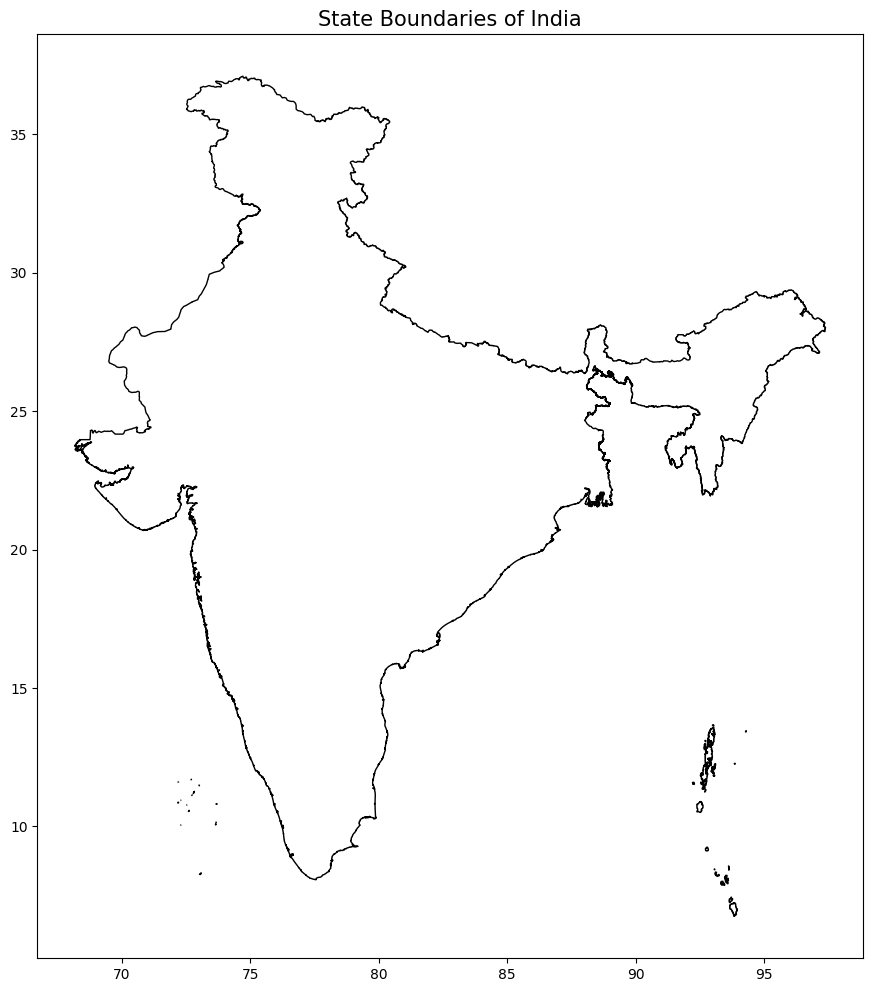

In [23]:
import matplotlib.pyplot as plt

# Plot the boundaries (no fill)
gdf.boundary.plot(color="black", linewidth=1.0, figsize=(12, 12))
plt.title("State Boundaries of India", fontsize=15)
plt.show()


In [24]:
# Check the first few rows and properties of the GeoDataFrame to verify what it contains
print(gdf.head())

# Check for columns that represent the boundaries, for example:
print(gdf.columns)  # To see which columns are available


                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Index(['geometry'], dtype='object')


In [25]:
!pip install geopandas altair


In [27]:
import geopandas as gpd

# Load the GeoJSON file
gdf = gpd.read_file('/path/to/your/india_states.geojson')

# Check the structure of the GeoDataFrame to confirm it contains the required data
print(gdf.head())


DataSourceError: /path/to/your/india_states.geojson: No such file or directory

In [28]:
from google.colab import files
uploaded = files.upload()


Saving india_states.geojson to india_states (1).geojson


In [29]:
# Import necessary libraries
import geopandas as gpd
import altair as alt
from google.colab import files

# Upload the GeoJSON file for India states (run this code in a cell to upload the file)
uploaded = files.upload()

# Load the GeoJSON file into a GeoDataFrame (replace 'india_states.geojson' with the actual uploaded file name if needed)
gdf = gpd.read_file('india_states.geojson')

# Display the first few rows of the dataframe to check the column names and structure
print(gdf.head())

# Check the column names to find the one with state names
print(gdf.columns)

# Assume the column with state names is 'state_name'. If it's different, change it accordingly.
# Example GeoPandas GeoDataFrame to Altair format
gdf['geojson'] = gdf.geometry.apply(lambda x: x.__geo_interface__)

# Create a map with state boundaries and tooltips using Altair
chart = alt.Chart(gdf).mark_geoshape().encode(
    tooltip=['state_name:N'],  # Tooltip will show the state names
).project('identity').properties(
    title="Base Map of Indian States with Tooltips",
    width=800,
    height=600
)

# Show the map with tooltips when hovering over each state
chart.show()


Saving india_states.geojson to india_states (2).geojson
                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Index(['geometry'], dtype='object')


alt.Chart(...)

In [30]:
# Import necessary libraries
import geopandas as gpd
import altair as alt
from google.colab import files

# Upload the GeoJSON file for India states (run this code in a cell to upload the file)
uploaded = files.upload()

# Load the GeoJSON file into a GeoDataFrame (replace 'india_states.geojson' with the actual uploaded file name if needed)
gdf = gpd.read_file('india_states.geojson')

# Check the first few rows to understand the structure
print(gdf.head())

# Check the column names to identify the state name column
print(gdf.columns)

# Assume the column with state names is 'state_name' or update to the actual column name if different
# Example: If it's 'NAME_1', use that instead of 'state_name'

# Ensure the 'state_name' column exists
if 'state_name' not in gdf.columns:
    print("State names column not found. Please check the column names.")
else:
    # Convert GeoDataFrame geometry to GeoJSON for Altair
    gdf['geojson'] = gdf.geometry.apply(lambda x: x.__geo_interface__)

    # Create a base map using Altair, including borders and tooltips
    chart = alt.Chart(gdf).mark_geoshape(
        stroke='black',  # Black stroke for clear boundaries
        strokeWidth=1    # Make the boundaries more visible
    ).encode(
        tooltip=['state_name:N']  # Ensure state names are shown in the tooltip
    ).project('identity').properties(
        title="Base Map of Indian States with Tooltips",
        width=800,
        height=600
    )

    chart.show()


Saving india_states.geojson to india_states (3).geojson
                                            geometry
0  MULTIPOLYGON (((77.51873 35.48566, 77.51874 35...
Index(['geometry'], dtype='object')
State names column not found. Please check the column names.


In [33]:
import folium
import json

# Load the GeoJSON file
with open('india_states.geojson') as f:
    india_states = json.load(f)

# Create a map centered around India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Add the GeoJSON layer to the map with tooltips
folium.GeoJson(
    india_states,
    name='Indian States',
    tooltip=folium.GeoJsonTooltip(fields=['NAME_1'], aliases=['State:'])
).add_to(m)

# Save the map to an HTML file
m.save("india_map_with_tooltips.html")

print("The map of India with tooltips has been created and saved to india_map_with_tooltips.html.")

AssertionError: The field NAME_1 is not available in the data. Choose from: ().

In [34]:
import json

# Load the GeoJSON file
with open('india_states.geojson') as f:
    india_states = json.load(f)

# Inspect the structure of the GeoJSON file
print(india_states.keys())

# Inspect the first feature to understand its properties
print(india_states['features'][0].keys())
print(india_states['features'][0]['properties'].keys())

dict_keys(['type', 'crs', 'features'])
dict_keys(['type', 'properties', 'geometry'])
dict_keys([])


In [35]:
import folium
import json

# Load the GeoJSON file
with open('india_states.geojson') as f:
    india_states = json.load(f)

# Create a map centered around India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Add the GeoJSON layer to the map with tooltips
folium.GeoJson(
    india_states,
    name='Indian States',
    tooltip=folium.GeoJsonTooltip(fields=['<correct_field_name>'], aliases=['State:'])
).add_to(m)

# Save the map to an HTML file
m.save("india_map_with_tooltips.html")

print("The map of India with tooltips has been created and saved to india_map_with_tooltips.html.")

AssertionError: The field <correct_field_name> is not available in the data. Choose from: ().

In [36]:
import json

# Load the GeoJSON file
with open('india_states.geojson') as f:
    india_states = json.load(f)

# Inspect the structure of the GeoJSON file
print(india_states.keys())

# Inspect the first feature to understand its properties
print(india_states['features'][0].keys())
print(india_states['features'][0]['properties'].keys())

dict_keys(['type', 'crs', 'features'])
dict_keys(['type', 'properties', 'geometry'])
dict_keys([])


In [37]:
import folium
import json

# Load the GeoJSON file
with open('india_states.geojson') as f:
    india_states = json.load(f)

# Create a map centered around India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Add the GeoJSON layer to the map with tooltips
folium.GeoJson(
    india_states,
    name='Indian States',
    tooltip=folium.GeoJsonTooltip(fields=['<correct_field_name>'], aliases=['State:'])
).add_to(m)

# Save the map to an HTML file
m.save("india_map_with_tooltips.html")

print("The map of India with tooltips has been created and saved to india_map_with_tooltips.html.")

AssertionError: The field <correct_field_name> is not available in the data. Choose from: ().

In [38]:
import json
import pandas as pd
import altair as alt
import geopandas as gpd
from google.colab import files

# Upload india_state.json file
uploaded = files.upload()

# Load the JSON file into a GeoDataFrame
gdf = gpd.read_file('india_state.json')

# Check the columns to identify the state names and values for the choropleth
print(gdf.columns)
print(gdf.head())

# Assuming you have a 'state_name' and 'some_data_column' in your dataset
# 'some_data_column' should be the column you want to use for choropleth (e.g., population, GDP)
# Replace 'some_data_column' with the actual column you want to visualize

# Plotting Base Map (Neutral with only borders)
base_map = alt.Chart(gdf).mark_geoshape(
    stroke='black',  # Black stroke for clear boundaries
    strokeWidth=1    # Make the boundaries more visible
).encode(
    tooltip=['state_name:N']  # Tooltip with state names
).project('identity').properties(
    title="Base Map of Indian States",
    width=800,
    height=600
)

# Plotting Choropleth Map (Coloring the states based on data)
choropleth_map = alt.Chart(gdf).mark_geoshape().encode(
    color='some_data_column:Q',  # Apply coloring based on your chosen data column
    tooltip=['state_name:N', 'some_data_column:Q']  # Tooltip with state name and data value
).project('identity').properties(
    title="Choropleth Map of Indian States with Data",
    width=800,
    height=600
)

# Combine both the base map and choropleth map
final_map = base_map + choropleth_map

# Show the map
final_map.show()


Saving india_state.json to india_state.json


DataSourceError: 'india_state.json' not recognized as being in a supported file format. It might help to specify the correct driver explicitly by prefixing the file path with '<DRIVER>:', e.g. 'CSV:path'.

In [39]:
# Read the JSON content
import json

# Load the JSON file into a Python dictionary
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Print the first 2 items in the data to inspect the structure
print(json.dumps(data, indent=4)[:2000])  # Printing first 2000 characters for inspection


{
    "$schema": "https://vega.github.io/schema/vega-lite/v5.json",
    "title": {
        "text": "Literacy in India",
        "subtitle": [
            "Literacy Rate by District, 2011 Census",
            ""
        ],
        "anchor": "start",
        "fontSize": 16,
        "subtitleFontSize": 12,
        "subtitleFontWeight": "lighter"
    },
    "width": 360,
    "height": 450,
    "data": {
        "url": "https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/india_districts.topojson",
        "format": {
            "type": "topojson",
            "feature": "india-districts-727"
        }
    },
    "transform": [
        {
            "calculate": "toNumber(datum.properties.dt_code)",
            "as": "id"
        },
        {
            "lookup": "id",
            "from": {
                "data": {
                    "url": "https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/indian_literacy_rates_wide.c

In [40]:
import geopandas as gpd
import json
from shapely.geometry import shape

# Load the JSON data into Python
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Convert it to GeoDataFrame
features = data['features']  # Assuming it's similar to GeoJSON format
gdf = gpd.GeoDataFrame.from_features(features)

# Check the GeoDataFrame structure
print(gdf.head())


KeyError: 'features'

In [41]:
import json

# Load the JSON file into a Python dictionary
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Print the entire structure of the JSON to understand its content
print(json.dumps(data, indent=4))


{
    "$schema": "https://vega.github.io/schema/vega-lite/v5.json",
    "title": {
        "text": "Literacy in India",
        "subtitle": [
            "Literacy Rate by District, 2011 Census",
            ""
        ],
        "anchor": "start",
        "fontSize": 16,
        "subtitleFontSize": 12,
        "subtitleFontWeight": "lighter"
    },
    "width": 360,
    "height": 450,
    "data": {
        "url": "https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/india_districts.topojson",
        "format": {
            "type": "topojson",
            "feature": "india-districts-727"
        }
    },
    "transform": [
        {
            "calculate": "toNumber(datum.properties.dt_code)",
            "as": "id"
        },
        {
            "lookup": "id",
            "from": {
                "data": {
                    "url": "https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/indian_literacy_rates_wide.c

In [42]:
[
    {
        "state_name": "Andhra Pradesh",
        "geometry": {
            "type": "Polygon",
            "coordinates": [...]
        }
    },
    ...
]


[{'state_name': 'Andhra Pradesh',
  'geometry': {'type': 'Polygon', 'coordinates': [Ellipsis]}},
 Ellipsis]

In [43]:
{
    "states": [
        {
            "name": "Andhra Pradesh",
            "geometry": { "type": "Polygon", "coordinates": [...] }
        },
        ...
    ]
}


{'states': [{'name': 'Andhra Pradesh',
   'geometry': {'type': 'Polygon', 'coordinates': [Ellipsis]}},
  Ellipsis]}

In [44]:
import geopandas as gpd
from shapely.geometry import shape

# Load the JSON data into Python
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Assuming the JSON structure is a list of states with 'geometry' and 'state_name'
gdf = gpd.GeoDataFrame(data, geometry=gpd.GeoSeries.from_wkt([state['geometry'] for state in data]))

# Now you can plot the GeoDataFrame
gdf.plot()


TypeError: string indices must be integers

In [45]:
print(type(data))  # Check if it's a dictionary or a list


<class 'dict'>


In [46]:
[
    {"state_name": "Andhra Pradesh", "geometry": {"type": "Polygon", "coordinates": [...]}}
]


[{'state_name': 'Andhra Pradesh',
  'geometry': {'type': 'Polygon', 'coordinates': [Ellipsis]}}]

In [47]:
states = data["states"]  # If data is a dictionary containing a list of states


KeyError: 'states'

In [48]:
import json

# Load the JSON data
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Print the structure of the loaded data
print(data)


{'$schema': 'https://vega.github.io/schema/vega-lite/v5.json', 'title': {'text': 'Literacy in India', 'subtitle': ['Literacy Rate by District, 2011 Census', ''], 'anchor': 'start', 'fontSize': 16, 'subtitleFontSize': 12, 'subtitleFontWeight': 'lighter'}, 'width': 360, 'height': 450, 'data': {'url': 'https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/india_districts.topojson', 'format': {'type': 'topojson', 'feature': 'india-districts-727'}}, 'transform': [{'calculate': 'toNumber(datum.properties.dt_code)', 'as': 'id'}, {'lookup': 'id', 'from': {'data': {'url': 'https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/indian_literacy_rates_wide.csv'}, 'key': 'district_id', 'fields': ['male_rate', 'female_rate', 'total_rate', 'difference_rate', 'district_name']}}], 'projection': {'type': 'naturalEarth1'}, 'layer': [{'mark': {'type': 'geoshape'}, 'encoding': {'color': {'value': 'rgb(200,200,200)'}}}, {'mark': {'type': 'geosha

In [49]:
import geopandas as gpd
import json

# Load the JSON data
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Access the 'features' key, which contains the state data
features = data['features']

# Create a GeoDataFrame from the features
gdf = gpd.GeoDataFrame.from_features(features)

# Plot the GeoDataFrame
gdf.plot()


KeyError: 'features'

In [50]:
import geopandas as gpd
import json

# Load the JSON data
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Create a GeoDataFrame from the list of states
gdf = gpd.GeoDataFrame(data, geometry=gpd.GeoSeries.from_wkt([state['geometry'] for state in data]))

# Plot the GeoDataFrame
gdf.plot()


TypeError: string indices must be integers

In [51]:
from google.colab import files

# Upload the file
uploaded = files.upload()


Saving india_state.json to india_state (1).json


In [52]:
import json

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Print the structure to understand the keys and values
print(json.dumps(data, indent=4))


{
    "$schema": "https://vega.github.io/schema/vega-lite/v5.json",
    "title": {
        "text": "Literacy in India",
        "subtitle": [
            "Literacy Rate by District, 2011 Census",
            ""
        ],
        "anchor": "start",
        "fontSize": 16,
        "subtitleFontSize": 12,
        "subtitleFontWeight": "lighter"
    },
    "width": 360,
    "height": 450,
    "data": {
        "url": "https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/india_districts.topojson",
        "format": {
            "type": "topojson",
            "feature": "india-districts-727"
        }
    },
    "transform": [
        {
            "calculate": "toNumber(datum.properties.dt_code)",
            "as": "id"
        },
        {
            "lookup": "id",
            "from": {
                "data": {
                    "url": "https://raw.githubusercontent.com/EconomicsObservatory/courses/main/datasets/advanced/indian_literacy_rates_wide.c

In [53]:
import geopandas as gpd

# Assuming 'features' key holds the geographical data
if 'features' in data:
    features = data['features']
else:
    features = data  # If data is already a list of features

# Convert the list of features into a GeoDataFrame
gdf = gpd.GeoDataFrame.from_features(features)

# Plot the map
gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
plt.title("Base Map of Indian States")
plt.show()


TypeError: string indices must be integers

In [54]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt  # Import matplotlib.pyplot

# Load the JSON data
with open('india_state.json', 'r') as file:
    data = json.load(file)

# Assuming 'features' key holds the geographical data
if 'features' in data:
    features = data['features']
else:
    features = data  # If data is already a list of features

# Check if features is a list and if the first item has 'geometry' as a key
if isinstance(features, list) and len(features) > 0 and isinstance(features[0], dict) and 'geometry' in features[0]:
    # If 'geometry' key is present, convert to GeoDataFrame
    gdf = gpd.GeoDataFrame.from_features(features)

    # Plot the map
    gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
    plt.title("Base Map of Indian States")
    plt.show()
else:
    print("Error: 'features' key not found or incorrect format in JSON data. The data should contain a list of features where each feature has a 'geometry' key.")
    print("Please check the structure of your 'india_state.json' file.")

Error: 'features' key not found or incorrect format in JSON data. The data should contain a list of features where each feature has a 'geometry' key.
Please check the structure of your 'india_state.json' file.


In [55]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Check if 'features' key exists in the data
if 'features' in data:
    features = data['features']
else:
    features = data  # Assuming the data is already a list of features

# Convert the features into a GeoDataFrame
gdf = gpd.GeoDataFrame.from_features(features)

# Plot the GeoDataFrame (the base map)
gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
plt.title("Base Map of Indian States")
plt.show()


TypeError: string indices must be integers

AttributeError: The CRS attribute of a GeoDataFrame without an active geometry column is not defined. Use GeoDataFrame.set_geometry to set the active geometry column.

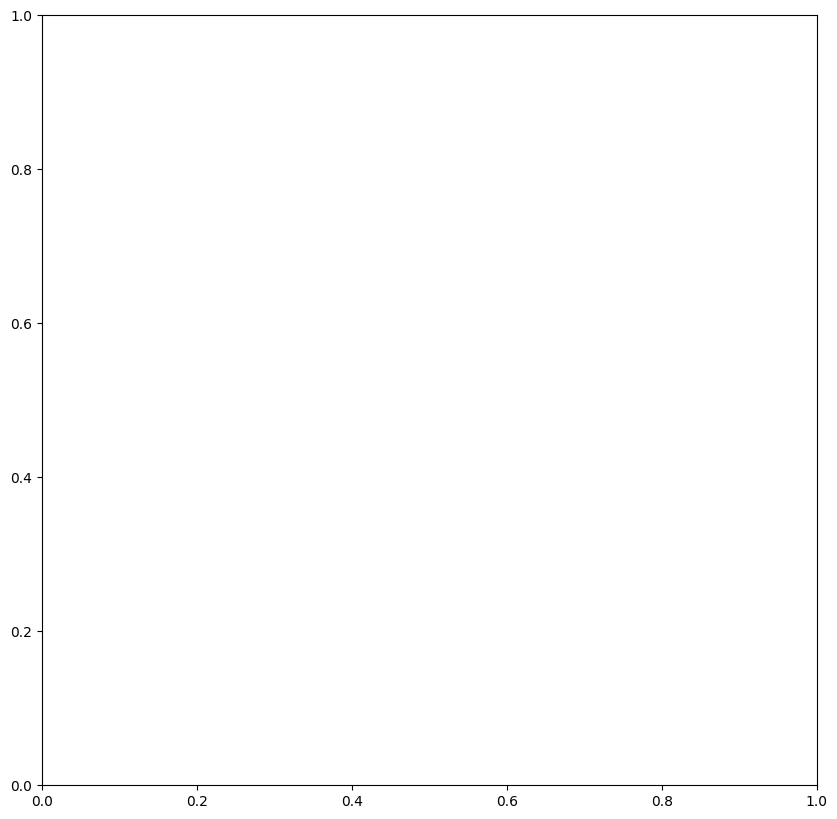

In [56]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Access the features (assuming it's under the 'features' key)
features = data.get('features', [])  # Use get to safely access 'features', defaults to empty list if not found

# Check if features is a list before converting to GeoDataFrame
if isinstance(features, list):
    gdf = gpd.GeoDataFrame.from_features(features)  # Load into a GeoDataFrame
else:
    print("Data is not in GeoJSON format. Check for a 'features' key containing a list of features.")


# Plot the GeoDataFrame (the base map)
if isinstance(gdf, gpd.GeoDataFrame):
    gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
    plt.title("Base Map of Indian States")
    plt.show()

In [57]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Access the features (assuming it's under the 'features' key)
features = data.get('features', [])  # Use get to safely access 'features', defaults to empty list if not found

# Check if features is a list before converting to GeoDataFrame
if isinstance(features, list):
    # Load into a GeoDataFrame, and set the geometry column explicitly.
    gdf = gpd.GeoDataFrame.from_features(features)
    # Assuming your geometry data is under the 'geometry' key in each feature
    gdf = gdf.set_geometry('geometry')  # Set the 'geometry' column as the active geometry
else:
    print("Data is not in GeoJSON format. Check for a 'features' key containing a list of features.")


# Plot the GeoDataFrame (the base map)
if isinstance(gdf, gpd.GeoDataFrame):
    gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
    plt.title("Base Map of Indian States")
    plt.show()

ValueError: Unknown column geometry

In [58]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Access the features (assuming it's under the 'features' key)
features = data.get('features', [])  # Use get to safely access 'features', defaults to empty list if not found

# Check if features is a list before converting to GeoDataFrame
if isinstance(features, list):
    # Load into a GeoDataFrame, and set the geometry column explicitly.
    gdf = gpd.GeoDataFrame.from_features(features)
    # Check if 'geometry' is in the columns, if not, assume it's under 'properties.geometry'
    if 'geometry' not in gdf.columns:
        # Assuming the geometry data is under the 'properties.geometry'
        gdf['geometry'] = gdf['properties'].apply(lambda x: x.get('geometry'))
        # Alternatively:
        # gdf = gdf.set_geometry(gpd.GeoSeries.from_wkt(gdf['properties'].apply(lambda x: x.get('geometry'))))

    gdf = gdf.set_geometry('geometry')  # Set the 'geometry' column as the active geometry
else:
    print("Data is not in GeoJSON format. Check for a 'features' key containing a list of features.")


# Plot the GeoDataFrame (the base map)
if isinstance(gdf, gpd.GeoDataFrame):
    gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
    plt.title("Base Map of Indian States")
    plt.show()

KeyError: 'properties'

In [59]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Access the features (assuming it's under the 'features' key)
features = data.get('features', [])  # Use get to safely access 'features', defaults to empty list if not found

# Check if features is a list before converting to GeoDataFrame
if isinstance(features, list):
    # Load into a GeoDataFrame, and set the geometry column explicitly.
    gdf = gpd.GeoDataFrame.from_features(features)
    # Check if 'geometry' is already a column (it usually is with GeoDataFrame.from_features)
    if 'geometry' not in gdf.columns:
        # If 'geometry' is not a direct column, check if it's nested under 'properties'
        if 'properties' in gdf.columns and gdf['properties'].apply(lambda x: isinstance(x, dict) and 'geometry' in x).any():
            gdf['geometry'] = gdf['properties'].apply(lambda x: x.get('geometry') if isinstance(x, dict) and 'geometry' in x else None)
        else:
            print("Error: 'geometry' data not found in expected locations. Please check the structure of your JSON file.")
            # Handle the case where geometry is not found appropriately (e.g., raise an exception, or try a different approach)

    gdf = gdf.set_geometry('geometry')  # Set the 'geometry' column as the active geometry
else:
    print("Data is not in GeoJSON format. Check for a 'features' key containing a list of features.")


# Plot the GeoDataFrame (the base map)
if isinstance(gdf, gpd.GeoDataFrame) and not gdf.empty:  # Check if gdf is not empty before plotting
    gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
    plt.title("Base Map of Indian States")
    plt.show()

Error: 'geometry' data not found in expected locations. Please check the structure of your JSON file.


ValueError: Unknown column geometry

In [60]:
import geopandas as gpd
import json
import matplotlib.pyplot as plt

# Load the uploaded JSON file
with open('india_state.json', 'r') as f:
    data = json.load(f)

# Access the features (assuming it's under the 'features' key)
features = data.get('features', [])  # Use get to safely access 'features', defaults to empty list if not found

# Check if features is a list before converting to GeoDataFrame
if isinstance(features, list):
    # Load into a GeoDataFrame, and set the geometry column explicitly.
    gdf = gpd.GeoDataFrame.from_features(features)
    # Check if 'geometry' is already a column (it usually is with GeoDataFrame.from_features)
    if 'geometry' not in gdf.columns:
        # If 'geometry' is not a direct column, check if it's nested under 'properties'
        if 'properties' in gdf.columns and gdf['properties'].apply(lambda x: isinstance(x, dict) and 'geometry' in x).any():
            # If 'geometry' is under 'properties', extract it
            gdf['geometry'] = gdf['properties'].apply(lambda x: x.get('geometry') if isinstance(x, dict) and 'geometry' in x else None)
        else:
            # If 'geometry' is not found under 'properties', try accessing it directly from features
            gdf['geometry'] = [feature.get('geometry') for feature in features]

    # Set the 'geometry' column as the active geometry, handling potential None values
    gdf = gdf.set_geometry('geometry', drop=True) #drop=True to remove rows with invalid geometries


else:
    print("Data is not in GeoJSON format. Check for a 'features' key containing a list of features.")


# Plot the GeoDataFrame (the base map)
if isinstance(gdf, gpd.GeoDataFrame) and not gdf.empty:  # Check if gdf is not empty before plotting
    gdf.plot(edgecolor='black', color='lightblue', figsize=(10, 10))
    plt.title("Base Map of Indian States")
    plt.show()

<ipython-input-60-8744388e5ddb>:24: FutureWarning: You are adding a column named 'geometry' to a GeoDataFrame constructed without an active geometry column. Currently, this automatically sets the active geometry column to 'geometry' but in the future that will no longer happen. Instead, either provide geometry to the GeoDataFrame constructor (GeoDataFrame(... geometry=GeoSeries()) or use `set_geometry('geometry')` to explicitly set the active geometry column.
  gdf['geometry'] = [feature.get('geometry') for feature in features]
<ipython-input-60-8744388e5ddb>:27: FutureWarning: The `drop` keyword argument is deprecated and in future the only supported behaviour will match drop=False. To silence this warning and adopt the future behaviour, stop providing `drop` as a keyword to `set_geometry`. To replicate the `drop=True` behaviour you should update your code to
`geo_col_name = gdf.active_geometry_name; gdf.set_geometry(new_geo_col).drop(columns=geo_col_name).rename_geometry(geo_col_name

In [61]:
!pip install folium


In [62]:
import folium
from folium import GeoJson
from folium.plugins import Tooltip

# Create a base map centered on India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Convert the GeoDataFrame into a geojson and add it to the map
geo_json_data = gdf.to_json()

# Add GeoJson with tooltips
folium.GeoJson(
    geo_json_data,
    name="india_states",
    tooltip=folium.GeoJsonTooltip(fields=["name"], aliases=["State:"]),
).add_to(m)

# Display the map
m


ImportError: cannot import name 'Tooltip' from 'folium.plugins' (/usr/local/lib/python3.10/dist-packages/folium/plugins/__init__.py)

In [63]:
!pip install --upgrade folium # upgrade to the latest folium version
import folium
from folium import GeoJson, features  # Import GeoJson and features

# Create a base map centered on India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Convert the GeoDataFrame into a geojson and add it to the map
geo_json_data = gdf.to_json()

# Add GeoJson with tooltips using features.GeoJsonTooltip
folium.GeoJson(
    geo_json_data,
    name="india_states",
    tooltip=features.GeoJsonTooltip(fields=["name"], aliases=["State:"]), # Use features.GeoJsonTooltip
).add_to(m)

# Display the map
m

AssertionError: The field name is not available in the data. Choose from: ().

In [64]:
m.save("india_states_map.html")


AssertionError: The field name is not available in the data. Choose from: ().

In [65]:
!pip install --upgrade folium # upgrade to the latest folium version
import folium
from folium import GeoJson, features  # Import GeoJson and features

# Create a base map centered on India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Convert the GeoDataFrame into a geojson and add it to the map
geo_json_data = gdf.to_json()

# Assuming 'NAME_1' is the column in your GeoDataFrame containing state names
# Add GeoJson with tooltips using features.GeoJsonTooltip and specifying the correct field
folium.GeoJson(
    geo_json_data,
    name="india_states",
    tooltip=features.GeoJsonTooltip(fields=["NAME_1"], aliases=["State:"]), # Use the correct field name here (e.g., 'NAME_1', 'state_name', etc.)
).add_to(m)

# Display the map
m

AssertionError: The field NAME_1 is not available in the data. Choose from: ().

In [66]:
# Assuming you have a dataset with population data in the 'data' dictionary
# Example: {'State1': 100000, 'State2': 200000, ...}

state_data = {
    "Andhra Pradesh": 50000000,
    "Bihar": 100000000,
    # Add other states' data
}

# Add color based on data (this is just an example, adjust accordingly)
folium.Choropleth(
    geo_data=geo_json_data,
    data=gdf['name'].map(state_data),
    columns=['name', 'value'],
    key_on="feature.properties.name",  # Adjust this based on your GeoJSON data
    fill_color="YlGn",  # Color scale (Yellow-Green)
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Population by State",
).add_to(m)

# Display the map
m


KeyError: 'name'

In [67]:
# Assuming 'NAME_1' is the column in your GeoDataFrame containing state names
# Add color based on data (this is just an example, adjust accordingly)
folium.Choropleth(
    geo_data=geo_json_data,
    data=gdf['NAME_1'].map(state_data),  # Replace 'name' with 'NAME_1' or the actual column name
    columns=['NAME_1', 'value'], # Replace 'name' with 'NAME_1'
    key_on="feature.properties.NAME_1",  # Replace 'name' with 'NAME_1' in key_on
    fill_color="YlGn",  # Color scale (Yellow-Green)
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Population by State",
).add_to(m)

# Display the map
m

KeyError: 'NAME_1'

In [68]:
# Assuming 'NAME_1' is the column in your GeoDataFrame containing state names
# Add color based on data (this is just an example, adjust accordingly)
# ... (previous code) ...

# Get the actual state name column
state_name_column = gdf.columns[gdf.columns.str.contains('name', case=False)].iloc[0]  # Find column with 'name' in it (case-insensitive)

folium.Choropleth(
    geo_data=geo_json_data,
    data=gdf[state_name_column].map(state_data),  # Use the identified state name column
    columns=[state_name_column, 'value'], # Replace 'name' with the actual state name column
    key_on=f"feature.properties.{state_name_column}",  # Replace 'name' with the actual state name column in key_on
    fill_color="YlGn",  # Color scale (Yellow-Green)
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Population by State",
).add_to(m)

# Display the map
m

AttributeError: 'Index' object has no attribute 'iloc'

In [69]:
!pip install --upgrade folium # upgrade to the latest folium version
import folium
from folium import GeoJson, features  # Import GeoJson and features

# Create a base map centered on India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Convert the GeoDataFrame into a geojson and add it to the map
geo_json_data = gdf.to_json()

# Assuming 'NAME_1' is the column in your GeoDataFrame containing state names
# Add GeoJson with tooltips using features.GeoJsonTooltip and specifying the correct field
folium.GeoJson(
    geo_json_data,
    name="india_states",
    tooltip=features.GeoJsonTooltip(fields=["NAME_1"], aliases=["State:"]), # Use the correct field name here (e.g., 'NAME_1', 'state_name', etc.)
).add_to(m)



# Assuming you have a dataset with population data in the 'data' dictionary
# Example: {'State1': 100000, 'State2': 200000, ...}

state_data = {
    "Andhra Pradesh": 50000000,
    "Bihar": 100000000,
    # Add other states' data
}

# Get the actual state name column
state_name_column = gdf.columns[gdf.columns.str.contains('name', case=False)][0]  # Use [0] directly to access the first element

# Add color based on data (this is just an example, adjust accordingly)
folium.Choropleth(
    geo_data=geo_json_data,
    data=gdf[state_name_column].map(state_data),  # Use the identified state name column
    columns=[state_name_column, 'value'], # Replace 'name' with the actual state name column
    key_on=f"feature.properties.{state_name_column}",  # Replace 'name' with the actual state name column in key_on
    fill_color="YlGn",  # Color scale (Yellow-Green)
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Population by State",
).add_to(m)

# Display the map
m

IndexError: index 0 is out of bounds for axis 0 with size 0

In [70]:
# Get the actual state name column
state_name_column = next((col for col in gdf.columns if 'name' in col.lower()), None)

if state_name_column:
    folium.Choropleth(
        geo_data=geo_json_data,
        data=gdf[state_name_column].map(state_data),  # Use the identified state name column
        columns=[state_name_column, 'value'],  # Replace 'name' with the actual state name column
        key_on=f"feature.properties.{state_name_column}",  # Replace 'name' with the actual state name column in key_on
        fill_color="YlGn",  # Color scale (Yellow-Green)
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name="Population by State",
    ).add_to(m)
else:
    print("Warning: No column containing 'name' found in the GeoDataFrame. Choropleth will not be added.")

# Display the map
m

AssertionError: The field NAME_1 is not available in the data. Choose from: ().

In [71]:
!pip install --upgrade folium # upgrade to the latest folium version
import folium
from folium import GeoJson, features  # Import GeoJson and features

# Create a base map centered on India
m = folium.Map(location=[20.5937, 78.9629], zoom_start=5)

# Convert the GeoDataFrame into a geojson and add it to the map
geo_json_data = gdf.to_json()

# **Get the actual state name column (fix)**
# Instead of assuming 'NAME_1', find the column that contains 'name' (case-insensitive)
state_name_column = next((col for col in gdf.columns if 'name' in col.lower()), None)

# Check if the state name column was found
if state_name_column:
    # Add GeoJson with tooltips using the identified state name column
    folium.GeoJson(
        geo_json_data,
        name="india_states",
        tooltip=features.GeoJsonTooltip(fields=[state_name_column], aliases=["State:"]),  # Use the identified state name column here
    ).add_to(m)
else:
    print("Warning: No column containing 'name' found in the GeoDataFrame. Tooltips will not be added.")


# Assuming you have a dataset with population data in the 'data' dictionary
# Example: {'State1': 100000, 'State2': 200000, ...}
state_data = {
    "Andhra Pradesh": 50000000,
    "Bihar": 100000000,
    # Add other states' data
}

# Add color based on data (this is just an example, adjust accordingly)
if state_name_column: # Only add Choropleth if state_name_column is found
    folium.Choropleth(
        geo_data=geo_json_data,
        data=gdf[state_name_column].map(state_data),  # Use the identified state name column
        columns=[state_name_column, 'value'],  # Replace 'name' with the actual state name column
        key_on=f"feature.properties.{state_name_column}",  # Replace 'name' with the actual state name column in key_on
        fill_color="YlGn",  # Color scale (Yellow-Green)
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name="Population by State",
    ).add_to(m)
else:
    print("Warning: No column containing 'name' found in the GeoDataFrame. Choropleth will not be added.")

# Display the map
m

In [1]:
pip install pandas plotly


In [2]:
import pandas as pd
import plotly.express as px
from dash import Dash, dcc, html

# Load the data
df = pd.read_csv('your_data.csv')

# Data Preprocessing (melt the dataframe for easy plotting)
df_melted = df.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                    var_name="Year", value_name="Value")

# Convert 'Year' column to numeric
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')

# Initialize the Dash app
app = Dash(__name__)

# App layout
app.layout = html.Div([
    html.H1("Interactive Mortality Rate Line Graph"),

    # Dropdown for selecting country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df['Country Name'].unique()],
        value='Afghanistan',  # Default country
        style={'width': '50%'}
    ),

    # Slider for year range selection
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max()+1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]  # Default year range
    ),

    # Graph to display the plot
    dcc.Graph(id='line-graph')
])

# Callback to update the graph
@app.callback(
    dash.dependencies.Output('line-graph', 'figure'),
    [dash.dependencies.Input('country-dropdown', 'value'),
     dash.dependencies.Input('year-slider', 'value')]
)
def update_graph(selected_country, selected_year_range):
    # Filter data for the selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_year_range[0]) &
                            (df_melted['Year'] <= selected_year_range[1])]

    # Create the line graph
    fig = px.line(filtered_df,
                  x='Year',
                  y='Value',
                  title=f"Under-5 Mortality Rate in {selected_country}",
                  labels={"Value": "Mortality Rate (per 1,000 live births)", "Year": "Year"})

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


ModuleNotFoundError: No module named 'dash'

In [3]:
pip install dash


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 53.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.7/101.7 kB 8.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 228.0/228.0 kB 16.9 MB/s eta 0:00:00
  Attempting uninstall: Werkzeug
    Found existing installation: Werkzeug 3.1.3
    Uninstalling Werkzeug-3.1.3:
      Successfully uninstalled Werkzeug-3.1.3
  Attempting uninstall: Flask
    Found existing installation: Flask 3.1.0
    Uninstalling Flask-3.1.0:
      Successfully uninstalled Flask-3.1.0


In [4]:
import pandas as pd
import plotly.express as px
from dash import Dash, dcc, html

# Load the data
df = pd.read_csv('your_data.csv')

# Data Preprocessing (melt the dataframe for easy plotting)
df_melted = df.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                    var_name="Year", value_name="Value")

# Convert 'Year' column to numeric
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')

# Initialize the Dash app
app = Dash(__name__)

# App layout
app.layout = html.Div([
    html.H1("Interactive Mortality Rate Line Graph"),

    # Dropdown for selecting country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df['Country Name'].unique()],
        value='Afghanistan',  # Default country
        style={'width': '50%'}
    ),

    # Slider for year range selection
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max()+1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]  # Default year range
    ),

    # Graph to display the plot
    dcc.Graph(id='line-graph')
])

# Callback to update the graph
@app.callback(
    dash.dependencies.Output('line-graph', 'figure'),
    [dash.dependencies.Input('country-dropdown', 'value'),
     dash.dependencies.Input('year-slider', 'value')]
)
def update_graph(selected_country, selected_year_range):
    # Filter data for the selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_year_range[0]) &
                            (df_melted['Year'] <= selected_year_range[1])]

    # Create the line graph
    fig = px.line(filtered_df,
                  x='Year',
                  y='Value',
                  title=f"Under-5 Mortality Rate in {selected_country}",
                  labels={"Value": "Mortality Rate (per 1,000 live births)", "Year": "Year"})

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


FileNotFoundError: [Errno 2] No such file or directory: 'your_data.csv'

In [5]:
from google.colab import files
uploaded = files.upload()


Saving API_SH.DYN.MORT_DS2_en_csv_v2_967.csv to API_SH.DYN.MORT_DS2_en_csv_v2_967.csv


In [6]:
df = pd.read_csv('mortality_data.csv')


FileNotFoundError: [Errno 2] No such file or directory: 'mortality_data.csv'

In [7]:
import os
print(os.getcwd())


/content


In [8]:
df = pd.read_csv('/path/to/your/file/mortality_data.csv')


FileNotFoundError: [Errno 2] No such file or directory: '/path/to/your/file/mortality_data.csv'

In [9]:
import os
os.listdir()


['.config', 'API_SH.DYN.MORT_DS2_en_csv_v2_967.csv', 'sample_data']

In [10]:
df = pd.read_csv('mortality_data.csv')


FileNotFoundError: [Errno 2] No such file or directory: 'mortality_data.csv'

In [11]:
import pandas as pd
import plotly.express as px
from dash import Dash, dcc, html

# Load the data
df = pd.read_csv('your_data.csv')

# Data Preprocessing (melt the dataframe for easy plotting)
df_melted = df.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                    var_name="Year", value_name="Value")

# Convert 'Year' column to numeric
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')

# Initialize the Dash app
app = Dash(__name__)

# App layout
app.layout = html.Div([
    html.H1("Interactive Mortality Rate Line Graph"),

    # Dropdown for selecting country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df['Country Name'].unique()],
        value='Afghanistan',  # Default country
        style={'width': '50%'}
    ),

    # Slider for year range selection
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max()+1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]  # Default year range
    ),

    # Graph to display the plot
    dcc.Graph(id='line-graph')
])

# Callback to update the graph
@app.callback(
    dash.dependencies.Output('line-graph', 'figure'),
    [dash.dependencies.Input('country-dropdown', 'value'),
     dash.dependencies.Input('year-slider', 'value')]
)
def update_graph(selected_country, selected_year_range):
    # Filter data for the selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_year_range[0]) &
                            (df_melted['Year'] <= selected_year_range[1])]

    # Create the line graph
    fig = px.line(filtered_df,
                  x='Year',
                  y='Value',
                  title=f"Under-5 Mortality Rate in {selected_country}",
                  labels={"Value": "Mortality Rate (per 1,000 live births)", "Year": "Year"})

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


FileNotFoundError: [Errno 2] No such file or directory: 'your_data.csv'

In [12]:
import pandas as pd
import plotly.express as px
from dash import Dash, dcc, html

# Load the data using the correct file name
df = pd.read_csv('API_SH.DYN.MORT_DS2_en_csv_v2_967')

# Data Preprocessing (melt the dataframe for easy plotting)
df_melted = df.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                    var_name="Year", value_name="Value")

# Convert 'Year' column to numeric
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')

# Initialize the Dash app
app = Dash(__name__)

# App layout
app.layout = html.Div([
    html.H1("Interactive Mortality Rate Line Graph"),

    # Dropdown for selecting country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df['Country Name'].unique()],
        value='Afghanistan',  # Default country
        style={'width': '50%'}
    ),

    # Slider for year range selection
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max()+1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]  # Default year range
    ),

    # Graph to display the plot
    dcc.Graph(id='line-graph')
])

# Callback to update the graph
@app.callback(
    dash.dependencies.Output('line-graph', 'figure'),
    [dash.dependencies.Input('country-dropdown', 'value'),
     dash.dependencies.Input('year-slider', 'value')]
)
def update_graph(selected_country, selected_year_range):
    # Filter data for the selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_year_range[0]) &
                            (df_melted['Year'] <= selected_year_range[1])]

    # Create the line graph
    fig = px.line(filtered_df,
                  x='Year',
                  y='Value',
                  title=f"Under-5 Mortality Rate in {selected_country}",
                  labels={"Value": "Mortality Rate (per 1,000 live births)", "Year": "Year"})

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


FileNotFoundError: [Errno 2] No such file or directory: 'API_SH.DYN.MORT_DS2_en_csv_v2_967'

In [13]:
pip install pandas dash plotly


In [14]:
from google.colab import files
uploaded = files.upload()


Saving API_SH.DYN.MORT_DS2_en_csv_v2_967.csv to API_SH.DYN.MORT_DS2_en_csv_v2_967 (1).csv


In [15]:
import pandas as pd
import plotly.express as px
from dash import Dash, dcc, html
import dash

# Load the uploaded file
df = pd.read_csv('API_SH.DYN.MORT_DS2_en_csv_v2_967.csv')

# Check the first few rows of the dataset to understand its structure
df.head()

# Data Preprocessing (melt the dataframe for easy plotting)
df_melted = df.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                    var_name="Year", value_name="Value")

# Convert 'Year' column to numeric
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')

# Initialize the Dash app
app = Dash(__name__)

# App layout
app.layout = html.Div([
    html.H1("Interactive Mortality Rate Line Graph"),

    # Dropdown for selecting country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df['Country Name'].unique()],
        value='Afghanistan',  # Default country
        style={'width': '50%'}
    ),

    # Slider for year range selection
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max()+1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]  # Default year range
    ),

    # Graph to display the plot
    dcc.Graph(id='line-graph')
])

# Callback to update the graph
@app.callback(
    dash.dependencies.Output('line-graph', 'figure'),
    [dash.dependencies.Input('country-dropdown', 'value'),
     dash.dependencies.Input('year-slider', 'value')]
)
def update_graph(selected_country, selected_year_range):
    # Filter data for the selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_year_range[0]) &
                            (df_melted['Year'] <= selected_year_range[1])]

    # Create the line graph
    fig = px.line(filtered_df,
                  x='Year',
                  y='Value',
                  title=f"Under-5 Mortality Rate in {selected_country}",
                  labels={"Value": "Mortality Rate (per 1,000 live births)", "Year": "Year"})

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


KeyError: "The following id_vars or value_vars are not present in the DataFrame: ['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code']"

In [16]:
pip install pandas plotly dash


In [17]:
import pandas as pd

# Load the updated CSV file
df = pd.read_csv('Worldbank_Mortality.csv')

# Check the column names to understand the structure
print(df.columns)


FileNotFoundError: [Errno 2] No such file or directory: 'Worldbank_Mortality.csv'

In [18]:
from google.colab import files
uploaded = files.upload()


Saving Worldbank_Mortality.csv to Worldbank_Mortality.csv


In [19]:
import pandas as pd

# Load the uploaded CSV file
df = pd.read_csv('Worldbank_mortality.csv')

# Check the column names to understand the structure
print(df.columns)


FileNotFoundError: [Errno 2] No such file or directory: 'Worldbank_mortality.csv'

In [ ]:
import pandas as pd

# Load the uploaded CSV file
df = pd.read_csv('Worldbank_mortality.csv')

# Check the column names to understand the structure
print(df.columns)


FileNotFoundError: [Errno 2] No such file or directory: 'Worldbank_mortality.csv'

In [20]:
import pandas as pd

# Load the uploaded CSV file
df = pd.read_csv('Worldbank_Mortality.csv')

# Check the column names to understand the structure
print(df.columns)


Index(['Country Name', 'Country Code', 'Indicator Name', 'Indicator Code',
       '1960', '1961', '1962', '1963', '1964', '1965', '1966', '1967', '1968',
       '1969', '1970', '1971', '1972', '1973', '1974', '1975', '1976', '1977',
       '1978', '1979', '1980', '1981', '1982', '1983', '1984', '1985', '1986',
       '1987', '1988', '1989', '1990', '1991', '1992', '1993', '1994', '1995',
       '1996', '1997', '1998', '1999', '2000', '2001', '2002', '2003', '2004',
       '2005', '2006', '2007', '2008', '2009', '2010', '2011', '2012', '2013',
       '2014', '2015', '2016', '2017', '2018', '2019', '2020', '2021', '2022'],
      dtype='object')


In [21]:
# Melt the dataframe for easier plotting
df_melted = df.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                    var_name="Year", value_name="Mortality Rate")

# Convert the 'Year' column to numeric and 'Mortality Rate' to float
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')
df_melted['Mortality Rate'] = pd.to_numeric(df_melted['Mortality Rate'], errors='coerce')

# Drop rows with missing values (if any)
df_melted = df_melted.dropna(subset=['Year', 'Mortality Rate'])

# Check the first few rows to confirm the data is ready
df_melted.head()


,Country Name,Country Code,Indicator Name,Indicator Code,Year,Mortality Rate
2,Afghanistan,AFG,"Mortality rate, under-5 (per 1,000 live births)",SH.DYN.MORT,1960,354.6
8,United Arab Emirates,ARE,"Mortality rate, under-5 (per 1,000 live births)",SH.DYN.MORT,1960,200.5
12,Antigua and Barbuda,ATG,"Mortality rate, under-5 (per 1,000 live births)",SH.DYN.MORT,1960,82.6
13,Australia,AUS,"Mortality rate, under-5 (per 1,000 live births)",SH.DYN.MORT,1960,24.9
14,Austria,AUT,"Mortality rate, under-5 (per 1,000 live births)",SH.DYN.MORT,1960,42.8


In [22]:
import dash
from dash import dcc, html
import plotly.express as px
import pandas as pd

# Load the data (assuming the data is already preprocessed as df_melted)
df_melted = pd.read_csv('Worldbank_mortality.csv')
df_melted = df_melted.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                           var_name="Year", value_name="Mortality Rate")
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')
df_melted['Mortality Rate'] = pd.to_numeric(df_melted['Mortality Rate'], errors='coerce')
df_melted = df_melted.dropna(subset=['Year', 'Mortality Rate'])

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    # Dropdown to select country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df_melted['Country Name'].unique()],
        value='India',  # Default value
        style={'width': '50%'}
    ),

    # Slider to select year range
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max() + 1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]
    ),

    # Graph for plotting the mortality rate
    dcc.Graph(id='mortality-graph')
])

# Callback to update the graph based on user input
@app.callback(
    dash.dependencies.Output('mortality-graph', 'figure'),
    [
        dash.dependencies.Input('country-dropdown', 'value'),
        dash.dependencies.Input('year-slider', 'value')
    ]
)
def update_graph(selected_country, selected_years):
    # Filter data based on selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_years[0]) &
                            (df_melted['Year'] <= selected_years[1])]

    # Create a plotly line graph
    fig = px.line(filtered_df, x='Year', y='Mortality Rate', title=f'Mortality Rate (Under 5) in {selected_country}',
                  labels={'Mortality Rate': 'Mortality Rate (per 1,000 live births)', 'Year': 'Year'})

    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


FileNotFoundError: [Errno 2] No such file or directory: 'Worldbank_mortality.csv'

In [23]:
import dash
from dash import dcc, html
import plotly.express as px
import pandas as pd

# Load the data (assuming the data is already preprocessed as df_melted)
df_melted = pd.read_csv('Worldbank_Mortality.csv')
df_melted = df_melted.melt(id_vars=["Country Name", "Country Code", "Indicator Name", "Indicator Code"],
                           var_name="Year", value_name="Mortality Rate")
df_melted['Year'] = pd.to_numeric(df_melted['Year'], errors='coerce')
df_melted['Mortality Rate'] = pd.to_numeric(df_melted['Mortality Rate'], errors='coerce')
df_melted = df_melted.dropna(subset=['Year', 'Mortality Rate'])

# Create a Dash app
app = dash.Dash(__name__)

# Layout of the app
app.layout = html.Div([
    # Dropdown to select country
    dcc.Dropdown(
        id='country-dropdown',
        options=[{'label': country, 'value': country} for country in df_melted['Country Name'].unique()],
        value='India',  # Default value
        style={'width': '50%'}
    ),

    # Slider to select year range
    dcc.RangeSlider(
        id='year-slider',
        min=df_melted['Year'].min(),
        max=df_melted['Year'].max(),
        step=1,
        marks={year: str(year) for year in range(df_melted['Year'].min(), df_melted['Year'].max() + 1, 5)},
        value=[df_melted['Year'].min(), df_melted['Year'].max()]
    ),

    # Graph for plotting the mortality rate
    dcc.Graph(id='mortality-graph')
])

# Callback to update the graph based on user input
@app.callback(
    dash.dependencies.Output('mortality-graph', 'figure'),
    [
        dash.dependencies.Input('country-dropdown', 'value'),
        dash.dependencies.Input('year-slider', 'value')
    ]
)
def update_graph(selected_country, selected_years):
    # Filter data based on selected country and year range
    filtered_df = df_melted[(df_melted['Country Name'] == selected_country) &
                            (df_melted['Year'] >= selected_years[0]) &
                            (df_melted['Year'] <= selected_years[1])]

    # Create a plotly line graph
    fig = px.line(filtered_df, x='Year', y='Mortality Rate', title=f'Mortality Rate (Under 5) in {selected_country}',
                  labels={'Mortality Rate': 'Mortality Rate (per 1,000 live births)', 'Year': 'Year'})

    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


<IPython.core.display.Javascript object>